In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

from test import detectors, draw_grid, load_images

images = load_images()

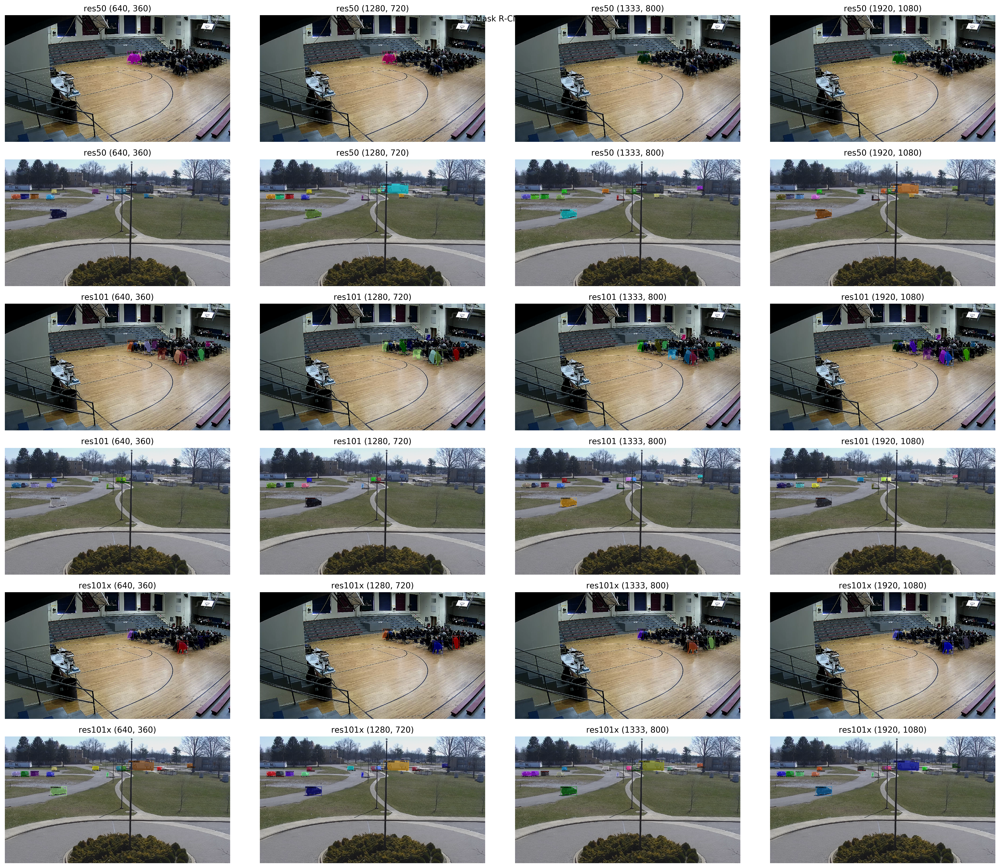

In [2]:
name = 'Mask R-CNN'
backbones = ['res50', 'res101', 'res101x']
input_shapes = [(640, 360), (1280, 720), (1333, 800), (1920, 1080)]

def set_shape(model, input_shape):
    model.cfg.INPUT.MAX_SIZE_TEST = max(input_shape)
    model.cfg.INPUT.MIN_SIZE_TEST = min(input_shape)

draw_grid(name, backbones, input_shapes, images, set_shape)

Using cache found in /home/lijun/.cache/torch/hub/ultralytics_yolov5_master



              from  n    params  module                                  arguments                     
  0             -1  1      3520  models.common.Focus                     [3, 32, 3]                    
  1             -1  1     18560  models.common.Conv                      [32, 64, 3, 2]                
  2             -1  1     20672  models.common.Bottleneck                [64, 64]                      
  3             -1  1     73984  models.common.Conv                      [64, 128, 3, 2]               
  4             -1  1    161152  models.common.BottleneckCSP             [128, 128, 3]                 
  5             -1  1    295424  models.common.Conv                      [128, 256, 3, 2]              
  6             -1  1    641792  models.common.BottleneckCSP             [256, 256, 3]                 
  7             -1  1   1180672  models.common.Conv                      [256, 512, 3, 2]              
  8             -1  1    656896  models.common.SPP             

Using cache found in /home/lijun/.cache/torch/hub/ultralytics_yolov5_master



              from  n    params  module                                  arguments                     
  0             -1  1      5280  models.common.Focus                     [3, 48, 3]                    
  1             -1  1     41664  models.common.Conv                      [48, 96, 3, 2]                
  2             -1  2     92736  models.common.Bottleneck                [96, 96]                      
  3             -1  1    166272  models.common.Conv                      [96, 192, 3, 2]               
  4             -1  1    639168  models.common.BottleneckCSP             [192, 192, 6]                 
  5             -1  1    664320  models.common.Conv                      [192, 384, 3, 2]              
  6             -1  1   2550144  models.common.BottleneckCSP             [384, 384, 6]                 
  7             -1  1   2655744  models.common.Conv                      [384, 768, 3, 2]              
  8             -1  1   1476864  models.common.SPP             

Using cache found in /home/lijun/.cache/torch/hub/ultralytics_yolov5_master



              from  n    params  module                                  arguments                     
  0             -1  1      7040  models.common.Focus                     [3, 64, 3]                    
  1             -1  1     73984  models.common.Conv                      [64, 128, 3, 2]               
  2             -1  3    246912  models.common.Bottleneck                [128, 128]                    
  3             -1  1    295424  models.common.Conv                      [128, 256, 3, 2]              
  4             -1  1   1627904  models.common.BottleneckCSP             [256, 256, 9]                 
  5             -1  1   1180672  models.common.Conv                      [256, 512, 3, 2]              
  6             -1  1   6499840  models.common.BottleneckCSP             [512, 512, 9]                 
  7             -1  1   4720640  models.common.Conv                      [512, 1024, 3, 2]             
  8             -1  1   2624512  models.common.SPP             

Using cache found in /home/lijun/.cache/torch/hub/ultralytics_yolov5_master



              from  n    params  module                                  arguments                     
  0             -1  1      8800  models.common.Focus                     [3, 80, 3]                    
  1             -1  1    115520  models.common.Conv                      [80, 160, 3, 2]               
  2             -1  4    513920  models.common.Bottleneck                [160, 160]                    
  3             -1  1    461440  models.common.Conv                      [160, 320, 3, 2]              
  4             -1  1   3311680  models.common.BottleneckCSP             [320, 320, 12]                
  5             -1  1   1844480  models.common.Conv                      [320, 640, 3, 2]              
  6             -1  1  13228160  models.common.BottleneckCSP             [640, 640, 12]                
  7             -1  1   7375360  models.common.Conv                      [640, 1280, 3, 2]             
  8             -1  1   4099840  models.common.SPP             

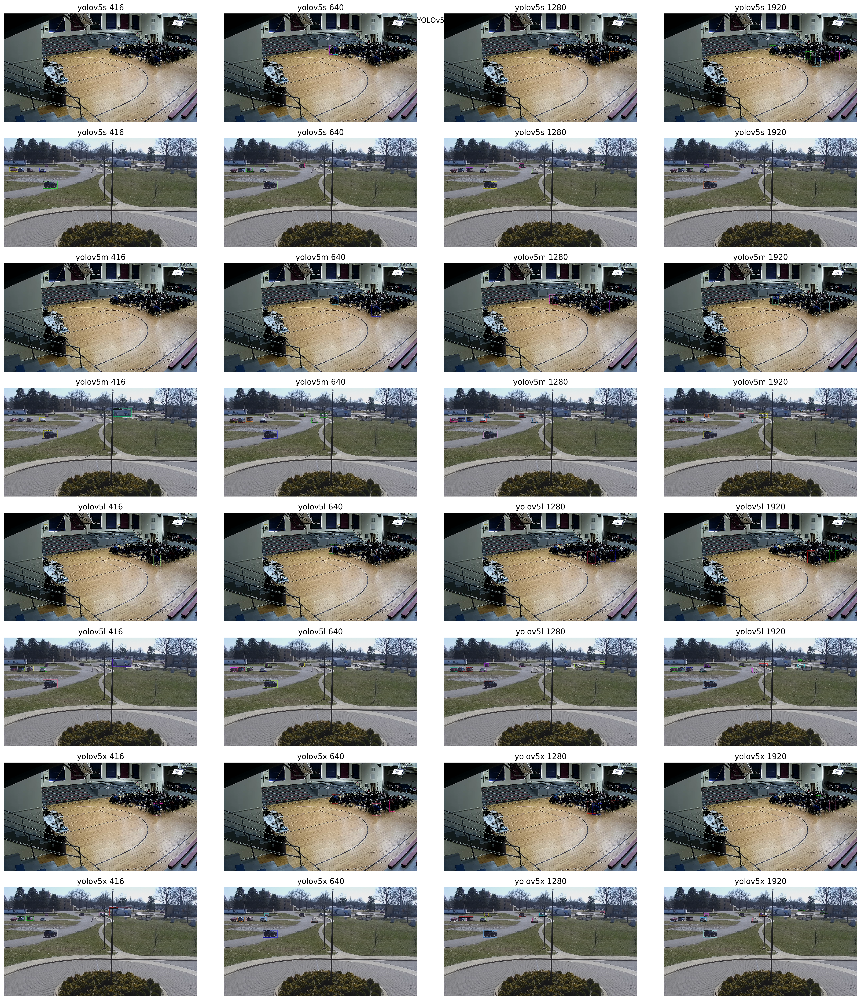

In [3]:
name = 'YOLOv5'
backbones = ['yolov5s', 'yolov5m', 'yolov5l', 'yolov5x']
input_shapes = [416, 640, 1280, 1920]

def set_shape(model, input_shape):
    model.model_input_shape = (input_shape, input_shape)

draw_grid(name, backbones, input_shapes, images, set_shape)

In [4]:
model = detectors.get('Mask R-CNN')(1, 'res101', (1920, 1080))
data = [*images.values()] * 4
detections = model(data)

In [5]:
%%timeit
detections = model(data)

989 ms ± 26.6 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [6]:
model = detectors.get('YOLOv5')(1, 'yolov5l', 1920)
data = [*images.values()] * 4
detections = model(data)


              from  n    params  module                                  arguments                     
  0             -1  1      7040  models.common.Focus                     [3, 64, 3]                    
  1             -1  1     73984  models.common.Conv                      [64, 128, 3, 2]               
  2             -1  3    246912  models.common.Bottleneck                [128, 128]                    
  3             -1  1    295424  models.common.Conv                      [128, 256, 3, 2]              
  4             -1  1   1627904  models.common.BottleneckCSP             [256, 256, 9]                 
  5             -1  1   1180672  models.common.Conv                      [256, 512, 3, 2]              
  6             -1  1   6499840  models.common.BottleneckCSP             [512, 512, 9]                 
  7             -1  1   4720640  models.common.Conv                      [512, 1024, 3, 2]             
  8             -1  1   2624512  models.common.SPP             

Using cache found in /home/lijun/.cache/torch/hub/ultralytics_yolov5_master


  9             -1  1  18105344  models.common.BottleneckCSP             [1024, 1024, 6]               
 10             -1  1  10234880  models.common.BottleneckCSP             [1024, 1024, 3, False]        
 11             -1  1    261375  torch.nn.modules.conv.Conv2d            [1024, 255, 1, 1]             
 12             -2  1         0  torch.nn.modules.upsampling.Upsample    [None, 2, 'nearest']          
 13        [-1, 6]  1         0  models.common.Concat                    [1]                           
 14             -1  1    787456  models.common.Conv                      [1536, 512, 1, 1]             
 15             -1  1   2561536  models.common.BottleneckCSP             [512, 512, 3, False]          
 16             -1  1    130815  torch.nn.modules.conv.Conv2d            [512, 255, 1, 1]              
 17             -2  1         0  torch.nn.modules.upsampling.Upsample    [None, 2, 'nearest']          
 18        [-1, 4]  1         0  models.common.Concat           

In [7]:
%%timeit
detections = model(data)

792 ms ± 520 µs per loop (mean ± std. dev. of 7 runs, 1 loop each)
